In [22]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import plotly.express as px
!pip install joypy
import joypy
from mpl_toolkits.mplot3d import Axes3D
from pandas.plotting import parallel_coordinates
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
import networkx as nx

In [4]:
df = pd.read_csv("Covid Data.csv")

df.head()

,USMER,MEDICAL_UNIT,SEX,PATIENT_TYPE,DATE_DIED,INTUBED,PNEUMONIA,AGE,PREGNANT,DIABETES,...,ASTHMA,INMSUPR,HIPERTENSION,OTHER_DISEASE,CARDIOVASCULAR,OBESITY,RENAL_CHRONIC,TOBACCO,CLASIFFICATION_FINAL,ICU
0,2,1,1,1,03/05/2020,97,1,65,2,2,...,2,2,1,2,2,2,2,2,3,97
1,2,1,2,1,03/06/2020,97,1,72,97,2,...,2,2,1,2,2,1,1,2,5,97
2,2,1,2,2,09/06/2020,1,2,55,97,1,...,2,2,2,2,2,2,2,2,3,2
3,2,1,1,1,12/06/2020,97,2,53,2,2,...,2,2,2,2,2,2,2,2,7,97
4,2,1,2,1,21/06/2020,97,2,68,97,1,...,2,2,1,2,2,2,2,2,3,97


In [5]:
# Display basic dataset information
df.info()

# Check for missing values
missing_values = df.isnull().sum()
missing_values[missing_values > 0]

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 21 columns):
 #   Column                Non-Null Count    Dtype 
---  ------                --------------    ----- 
 0   USMER                 1048575 non-null  int64 
 1   MEDICAL_UNIT          1048575 non-null  int64 
 2   SEX                   1048575 non-null  int64 
 3   PATIENT_TYPE          1048575 non-null  int64 
 4   DATE_DIED             1048575 non-null  object
 5   INTUBED               1048575 non-null  int64 
 6   PNEUMONIA             1048575 non-null  int64 
 7   AGE                   1048575 non-null  int64 
 8   PREGNANT              1048575 non-null  int64 
 9   DIABETES              1048575 non-null  int64 
 10  COPD                  1048575 non-null  int64 
 11  ASTHMA                1048575 non-null  int64 
 12  INMSUPR               1048575 non-null  int64 
 13  HIPERTENSION          1048575 non-null  int64 
 14  OTHER_DISEASE         1048575 non-null  int64 
 15

,0


In [6]:
# Display statistical summary of numeric columns
df.describe()

,USMER,MEDICAL_UNIT,SEX,PATIENT_TYPE,INTUBED,PNEUMONIA,AGE,PREGNANT,DIABETES,COPD,ASTHMA,INMSUPR,HIPERTENSION,OTHER_DISEASE,CARDIOVASCULAR,OBESITY,RENAL_CHRONIC,TOBACCO,CLASIFFICATION_FINAL,ICU
count,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06
mean,1.632194e+00,8.980565e+00,1.499259e+00,1.190765e+00,7.952288e+01,3.346831e+00,4.179410e+01,4.976558e+01,2.186404e+00,2.260569e+00,2.242626e+00,2.298132e+00,2.128989e+00,2.435143e+00,2.261810e+00,2.125176e+00,2.257180e+00,2.214333e+00,5.305653e+00,7.955397e+01
std,4.822084e-01,3.723278e+00,4.999997e-01,3.929041e-01,3.686889e+01,1.191288e+01,1.690739e+01,4.751073e+01,5.424242e+00,5.132258e+00,5.114089e+00,5.462843e+00,5.236397e+00,6.646676e+00,5.194850e+00,5.175445e+00,5.135354e+00,5.323097e+00,1.881165e+00,3.682307e+01
min,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,0.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00
25%,1.000000e+00,4.000000e+00,1.000000e+00,1.000000e+00,9.700000e+01,2.000000e+00,3.000000e+01,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,3.000000e+00,9.700000e+01
50%,2.000000e+00,1.200000e+01,1.000000e+00,1.000000e+00,9.700000e+01,2.000000e+00,4.000000e+01,9.700000e+01,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,6.000000e+00,9.700000e+01
75%,2.000000e+00,1.200000e+01,2.000000e+00,1.000000e+00,9.700000e+01,2.000000e+00,5.300000e+01,9.700000e+01,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,7.000000e+00,9.700000e+01
max,2.000000e+00,1.300000e+01,2.000000e+00,2.000000e+00,9.900000e+01,9.900000e+01,1.210000e+02,9.800000e+01,9.800000e+01,9.800000e+01,9.800000e+01,9.800000e+01,9.800000e+01,9.800000e+01,9.800000e+01,9.800000e+01,9.800000e+01,9.800000e+01,7.000000e+00,9.900000e+01


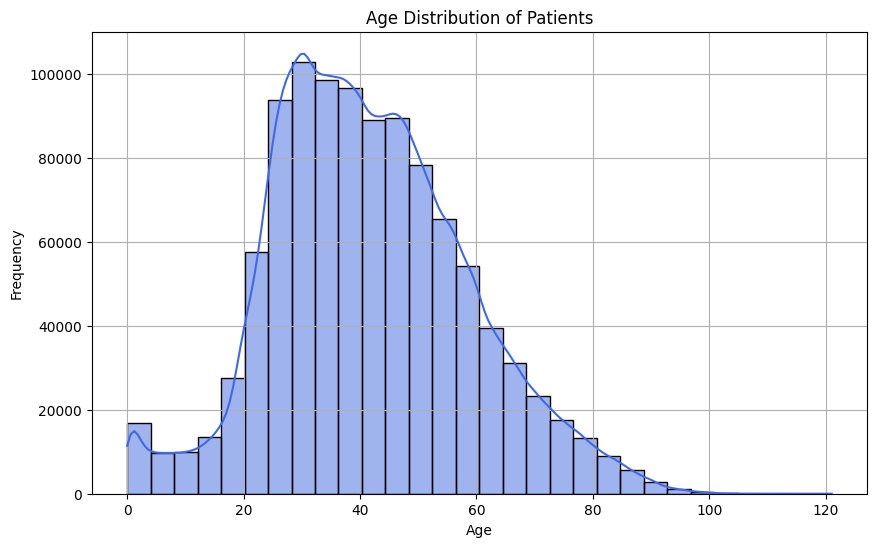

In [7]:
# Visualization 1: Age distribution of patients
plt.figure(figsize=(10, 6))
sns.histplot(df['AGE'], bins=30, kde=True, color='royalblue')
plt.title('Age Distribution of Patients')
plt.xlabel('Age')
plt.ylabel('Frequency')
plt.grid()
plt.show()

<ipython-input-8-7a7072d705b4>:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=df["DATE_DIED"] != "9999-99-99", y=df["AGE"], palette=["green", "red"])


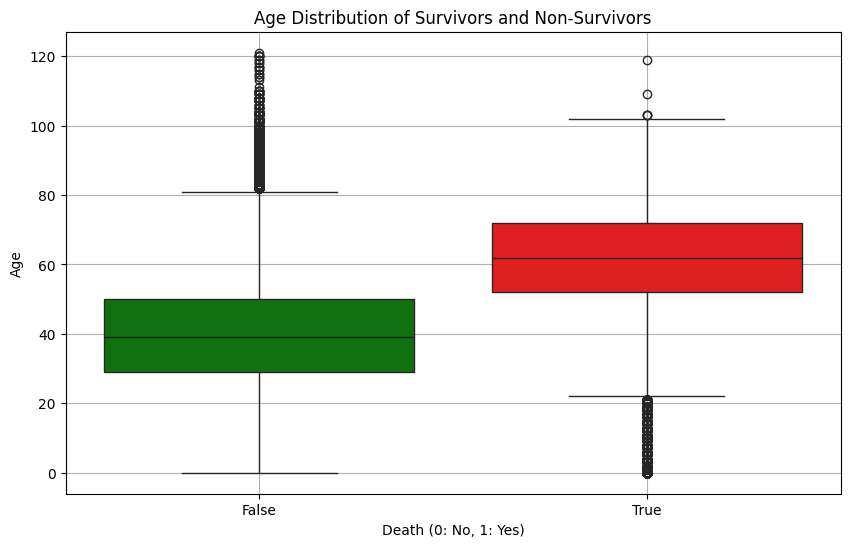

In [8]:
# Visualization 2: Mortality distribution based on age
plt.figure(figsize=(10, 6))
sns.boxplot(x=df["DATE_DIED"] != "9999-99-99", y=df["AGE"], palette=["green", "red"])
plt.title("Age Distribution of Survivors and Non-Survivors")
plt.xlabel("Death (0: No, 1: Yes)")
plt.ylabel("Age")
plt.grid()
plt.show()

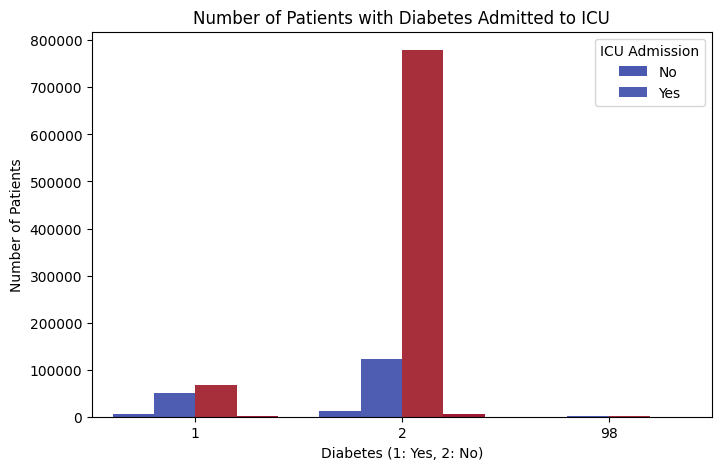

In [9]:
# Visualization 3: Diabetes and ICU Admission
plt.figure(figsize=(8, 5))
sns.countplot(x='DIABETES', hue='ICU', data=df, palette="coolwarm")
plt.title("Number of Patients with Diabetes Admitted to ICU")
plt.xlabel("Diabetes (1: Yes, 2: No)")
plt.ylabel("Number of Patients")
plt.legend(title="ICU Admission", labels=["No", "Yes"])
plt.show()

In [10]:
# Convert ICU and Diabetes to categorical for better visualization
df['ICU'] = df['ICU'].replace({97: "Unknown", 1: "Admitted", 2: "Not Admitted"})
df['DIABETES'] = df['DIABETES'].replace({1: "Yes", 2: "No"})

# Create 3D scatter plot
fig = px.scatter_3d(df, x='AGE', y='ICU', z='DIABETES',
                    color='AGE', size_max=10, opacity=0.8,
                    title="3D Scatter Plot: Age, ICU Admission & Diabetes",
                    color_continuous_scale='viridis')

fig.show()

In [11]:
# Create a new binary column: 1 if the person died, 0 otherwise
df['DIED'] = df['DATE_DIED'].apply(lambda x: 1 if x != "9999-99-99" else 0)

# Convert categorical columns for better readability
df['ICU'] = df['ICU'].replace({97: "Unknown", 1: "Admitted", 2: "Not Admitted"})
df['DIABETES'] = df['DIABETES'].replace({1: "Yes", 2: "No"})

In [12]:
fig = px.scatter_3d(df, x='AGE', y='ICU', z='DIED',
                    color='DIED', size_max=10, opacity=0.8,
                    title="3D Scatter Plot: Age, ICU Admission & Mortality",
                    color_continuous_scale='reds')

fig.show()

<ipython-input-13-0e9eccfca38e>:2: FutureWarning:

Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`



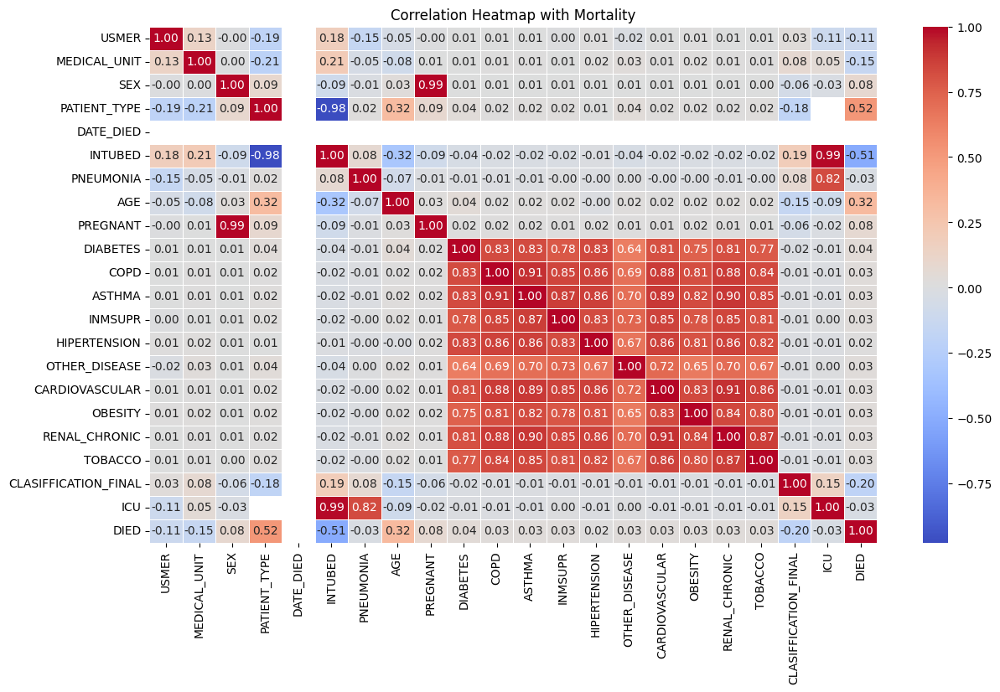

In [13]:
# Convert categorical to numeric
df_numeric = df.replace({'ICU': {"Unknown": np.nan, "Admitted": 1, "Not Admitted": 0},
                         'DIABETES': {"Yes": 1, "No": 0}})

# Convert 'DATE_DIED' to datetime and then to numerical representation
# Assuming 'DATE_DIED' is in 'MM/DD/YYYY' format, adjust if needed
df_numeric['DATE_DIED'] = pd.to_datetime(df_numeric['DATE_DIED'], format='%Y-%m-%d', errors='coerce')
df_numeric['DATE_DIED'] = df_numeric['DATE_DIED'].astype(np.int64) // 10**9  # Convert to Unix timestamp


# Compute correlation matrix
corr = df_numeric.corr()

# Create a heatmap
plt.figure(figsize=(14, 8))
sns.heatmap(corr, annot=True, cmap="coolwarm", linewidths=0.5, fmt=".2f")
plt.title("Correlation Heatmap with Mortality")
plt.show()

In [14]:
fig = px.sunburst(df, path=['ICU', 'DIABETES', 'HIPERTENSION', 'OBESITY', 'DIED'],
                  values='AGE', title="Sunburst Chart: ICU Admissions, Comorbidities & Mortality",
                  color='DIED', color_discrete_map={1:'red', 0:'blue'})
fig.show()

<Figure size 1200x800 with 0 Axes>

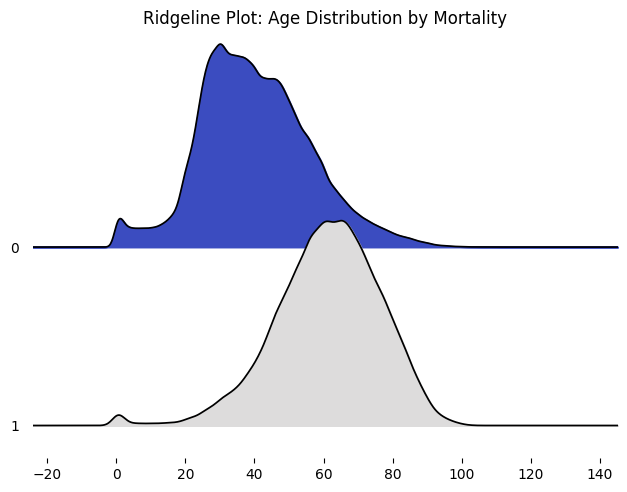

In [15]:
# Ridgeline Plot: Age Distribution by Mortality
plt.figure(figsize=(12, 8))
joypy.joyplot(data=df_numeric[['AGE', 'DIED']],
              by="DIED", colormap=plt.cm.coolwarm, linewidth=1.25)
plt.title("Ridgeline Plot: Age Distribution by Mortality")
plt.show()

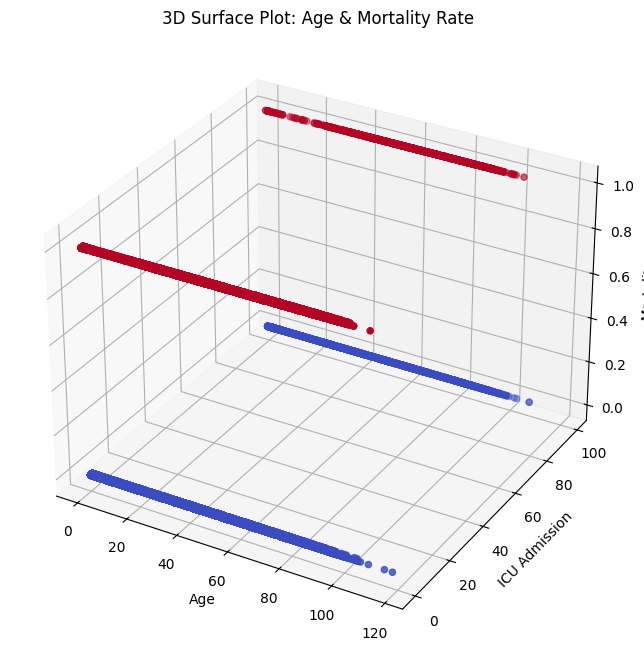

In [16]:
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')

# Generate data
x = df_numeric['AGE']
y = df_numeric['ICU']
z = df['DIED']

ax.scatter(x, y, z, c=z, cmap='coolwarm', marker='o')
ax.set_xlabel("Age")
ax.set_ylabel("ICU Admission")
ax.set_zlabel("Mortality")
ax.set_title("3D Surface Plot: Age & Mortality Rate")

plt.show()

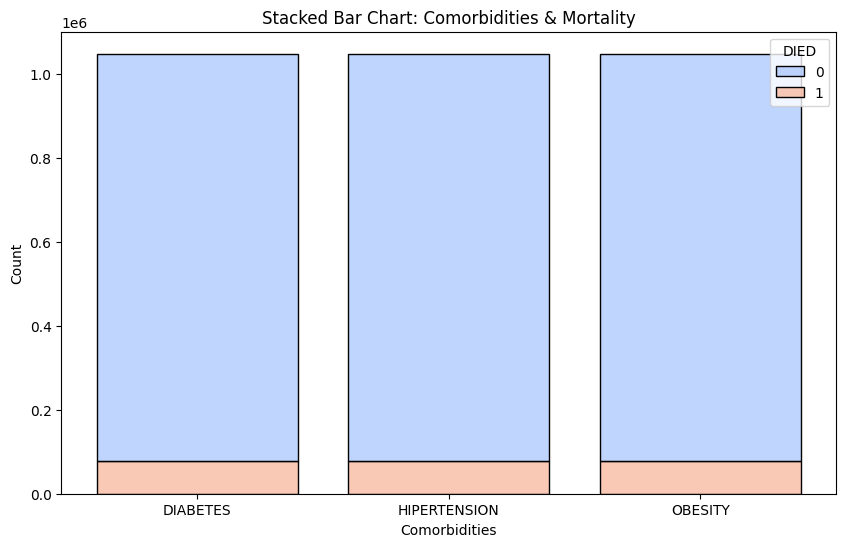

In [17]:
comorbidities = ['DIABETES', 'HIPERTENSION', 'OBESITY']
melted_df = df.melt(id_vars=['DIED'], value_vars=comorbidities)

plt.figure(figsize=(10, 6))
sns.histplot(data=melted_df, x="variable", hue="DIED", multiple="stack", palette="coolwarm", shrink=0.8)
plt.title("Stacked Bar Chart: Comorbidities & Mortality")
plt.xlabel("Comorbidities")
plt.ylabel("Count")
plt.show()

<ipython-input-18-6a8be218ea2a>:2: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


<ipython-input-18-6a8be218ea2a>:3: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




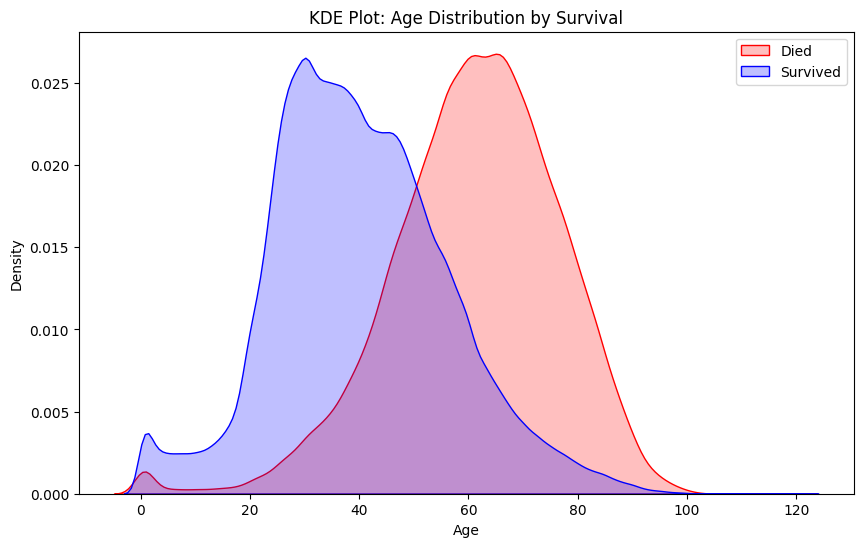

In [18]:
plt.figure(figsize=(10, 6))
sns.kdeplot(df[df['DIED'] == 1]['AGE'], label="Died", shade=True, color="red")
sns.kdeplot(df[df['DIED'] == 0]['AGE'], label="Survived", shade=True, color="blue")
plt.title("KDE Plot: Age Distribution by Survival")
plt.xlabel("Age")
plt.ylabel("Density")
plt.legend()
plt.show()

<ipython-input-19-ad812c0a09ea>:7: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

<ipython-input-19-ad812c0a09ea>:11: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




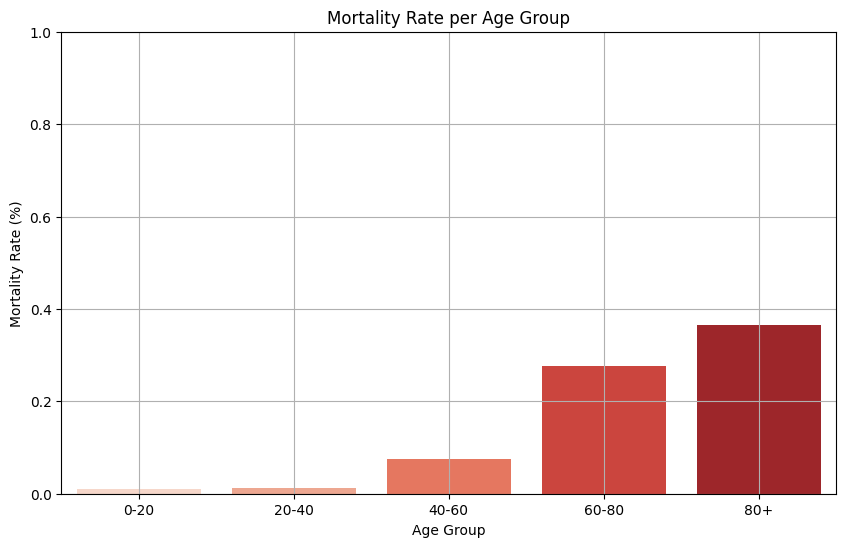

In [19]:
# Define age groups
bins = [0, 20, 40, 60, 80, 120]
labels = ["0-20", "20-40", "40-60", "60-80", "80+"]
df["AGE_GROUP"] = pd.cut(df["AGE"], bins=bins, labels=labels)

# Calculate survival rates
age_mortality = df.groupby("AGE_GROUP")["DIED"].mean()

# Plot the bar chart
plt.figure(figsize=(10, 6))
sns.barplot(x=age_mortality.index, y=age_mortality.values, palette="Reds")
plt.title("Mortality Rate per Age Group")
plt.xlabel("Age Group")
plt.ylabel("Mortality Rate (%)")
plt.ylim(0, 1)
plt.grid()
plt.show()


<ipython-input-32-62a705935aaa>:13: FutureWarning:

Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`



        AGE  ICU  DIABETES  HIPERTENSION  OBESITY  DIED
781974   35    2         0             2        2     0
937737   28    2         0             1        2     0
907828    7    2         0             2        2     0
784628   35    2         1             2        2     0
662460   33    2         0             2        2     0
AGE             int64
ICU             int64
DIABETES        int64
HIPERTENSION    int64
OBESITY         int64
DIED            int64
dtype: object


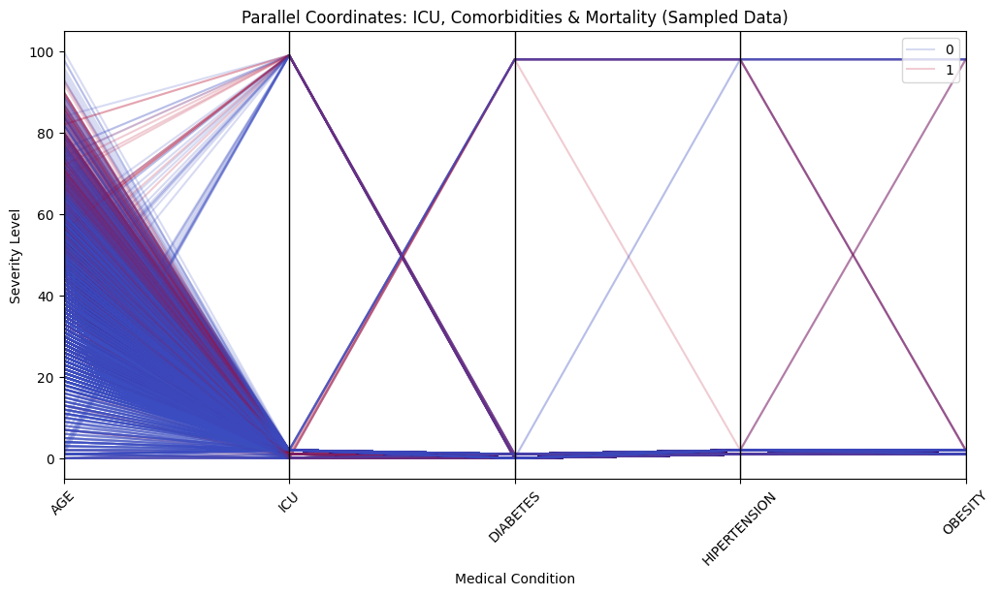

In [32]:
# Select relevant features
features = ["AGE", "ICU", "DIABETES", "HIPERTENSION", "OBESITY", "DIED"]
df_sample = df[features].dropna().sample(5000, random_state=42)  # Limit data for speed

# Convert all categorical columns to numerical values
category_mappings = {
    "ICU": {"Unknown": 2, "Admitted": 1, "Not Admitted": 0},
    "DIABETES": {"Yes": 1, "No": 0},
    "HIPERTENSION": {"Yes": 1, "No": 0},
    "OBESITY": {"Yes": 1, "No": 0}
}

df_sample.replace(category_mappings, inplace=True)

# Convert data to numeric explicitly
df_sample = df_sample.apply(pd.to_numeric, errors='coerce')

# Drop any remaining NaN values
df_sample = df_sample.dropna()

# Final check before plotting
print(df_sample.head())
print(df_sample.dtypes)

# Plot parallel coordinates
plt.figure(figsize=(12, 6))
parallel_coordinates(df_sample, class_column="DIED", colormap=plt.get_cmap("coolwarm"), alpha=0.2)
plt.title("Parallel Coordinates: ICU, Comorbidities & Mortality (Sampled Data)")
plt.xlabel("Medical Condition")
plt.ylabel("Severity Level")
plt.xticks(rotation=45)
plt.grid()
plt.show()

<ipython-input-21-f76ec1bc567c>:7: FutureWarning:

Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`

<ipython-input-21-f76ec1bc567c>:29: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




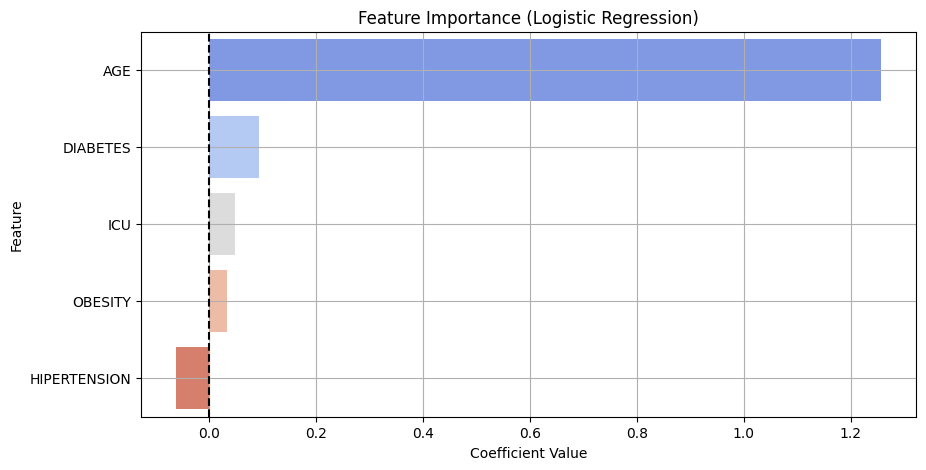

In [21]:
# Select features and target variable
features = ["AGE", "ICU", "DIABETES", "HIPERTENSION", "OBESITY"]
X = df[features].dropna()
y = df["DIED"].loc[X.index]

# Convert categorical variables to numerical representations
X = X.replace({
    "ICU": {"Unknown": 2, "Admitted": 1, "Not Admitted": 0},
    "DIABETES": {"Yes": 1, "No": 0},
    "HIPERTENSION": {"Yes": 1, "No": 0},  # Convert 'HIPERTENSION'
    "OBESITY": {"Yes": 1, "No": 0}  # Convert 'OBESITY'
})

# Standardize features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Train logistic regression model
model = LogisticRegression()
model.fit(X_scaled, y)

# Extract feature importance (coefficients)
importances = model.coef_[0]
feature_importance = pd.DataFrame({"Feature": features, "Importance": importances})
feature_importance = feature_importance.sort_values(by="Importance", ascending=False)

# Plot feature importance
plt.figure(figsize=(10, 5))
sns.barplot(x="Importance", y="Feature", data=feature_importance, palette="coolwarm")
plt.title("Feature Importance (Logistic Regression)")
plt.xlabel("Coefficient Value")
plt.ylabel("Feature")
plt.axvline(0, color="black", linestyle="--")
plt.grid()
plt.show()

<ipython-input-24-6da780f8d1d8>:2: FutureWarning:

Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`



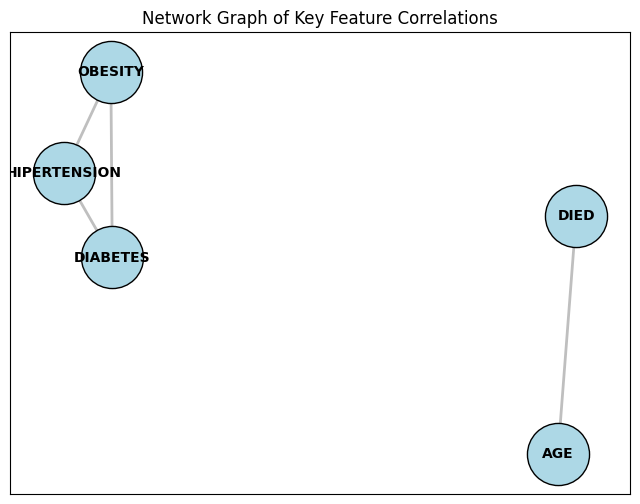

In [24]:
# Compute correlation matrix and filter for strong correlations
corr_matrix = df[["AGE", "DIED", "ICU", "DIABETES", "HIPERTENSION", "OBESITY"]].replace({
    "ICU": {"Unknown": 2, "Admitted": 1, "Not Admitted": 0},
    "DIABETES": {"Yes": 1, "No": 0},
    "HIPERTENSION": {"Yes": 1, "No": 0},
    "OBESITY": {"Yes": 1, "No": 0}
}).corr()  # Apply replace before calculating correlation

corr_threshold = 0.1  # Set a threshold for showing relationships
strong_corrs = corr_matrix[abs(corr_matrix) > corr_threshold]

# Create a graph from the correlation matrix
G = nx.Graph()

# Add nodes and edges
for col in strong_corrs.columns:
    for row in strong_corrs.index:
        if col != row and abs(strong_corrs.loc[row, col]) > corr_threshold:
            G.add_edge(col, row, weight=strong_corrs.loc[row, col])

# Plot the network
plt.figure(figsize=(8, 6))
pos = nx.spring_layout(G)
edges = G.edges(data=True)

# Draw nodes and edges
nx.draw_networkx_nodes(G, pos, node_size=2000, node_color="lightblue", edgecolors="black")
nx.draw_networkx_edges(G, pos, edgelist=[(u, v) for u, v, d in edges], width=2, alpha=0.5, edge_color="gray")
nx.draw_networkx_labels(G, pos, font_size=10, font_weight="bold")

plt.title("Network Graph of Key Feature Correlations")
plt.show()

In [25]:
# Convert DATE_DIED to datetime, setting invalid values to NaT (Not a Time)
df["DATE_DIED"] = pd.to_datetime(df["DATE_DIED"], errors="coerce")

# Drop NaN values (people who survived)
df_deaths = df.dropna(subset=["DATE_DIED"])

In [26]:
# Group deaths by date
df_time_series = df_deaths.groupby("DATE_DIED").size().reset_index(name="Deaths")

# Create animated bar chart
fig = px.bar(df_time_series, x="DATE_DIED", y="Deaths",
             title="Daily COVID-19 Deaths Over Time",
             labels={"DATE_DIED": "Date", "Deaths": "Number of Deaths"},
             animation_frame="DATE_DIED",
             range_y=[0, df_time_series["Deaths"].max()],
             template="plotly_dark")

fig.show()

<ipython-input-35-9a89f92c85d1>:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



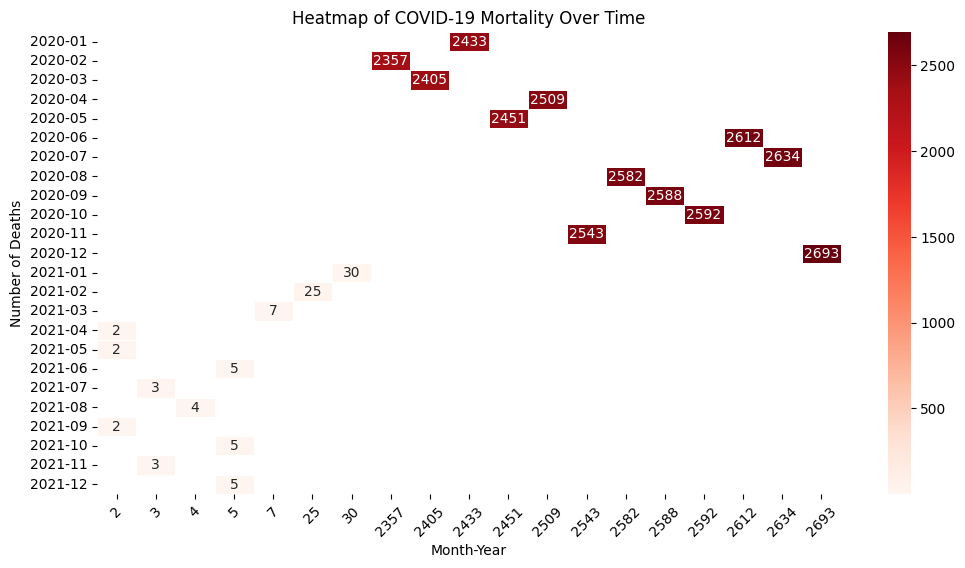

In [35]:
# Convert DATE_DIED to datetime and remove invalid dates
df["DATE_DIED"] = pd.to_datetime(df["DATE_DIED"], errors="coerce")

# Remove NaN values (survivors)
df_deaths = df.dropna(subset=["DATE_DIED"])

# Extract Year and Month as string format
df_deaths["YearMonth"] = df_deaths["DATE_DIED"].dt.strftime('%Y-%m')

# Count deaths per month
heatmap_data = df_deaths.groupby(["YearMonth"]).size().reset_index(name="Deaths")

# Convert to pivot table format for heatmap
# The original code had columns=[], which creates a Series
# Instead, create a dummy column to make it a DataFrame
heatmap_data = heatmap_data.pivot(index="YearMonth", columns=["Deaths"], values="Deaths") # Added a dummy column name 'Deaths'


# Plot heatmap
plt.figure(figsize=(12, 6))
sns.heatmap(heatmap_data, cmap="Reds", linewidths=0.5, annot=True, fmt=".0f")
plt.title("Heatmap of COVID-19 Mortality Over Time")
plt.xlabel("Month-Year")
plt.ylabel("Number of Deaths")
plt.xticks(rotation=45)
plt.show()